In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math

In [2]:
df_rd = pd.read_csv('roads_transposed.csv')
df_rd.head(5)

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.702917,90.450417
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.697889,90.460583


In [3]:
n1 = df_rd.groupby('road').get_group('N1')
n1

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.702917,90.450417
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.697889,90.460583
...,...,...,...,...
1343,N1,LRP466a,20.868860,92.298222
1344,N1,LRP466b,20.865028,92.298250
1345,N1,LRP466c,20.864667,92.298194
1346,N1,LRP467,20.862972,92.298083


In [4]:
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radius of the Earth in kilometers
    dlat = np.radians(lat2 - lat1)
    dlon = np.radians(lon2 - lon1)
    a = np.sin(dlat / 2) ** 2 + np.cos(np.radians(lat1)) * np.cos(np.radians(lat2)) * np.sin(dlon / 2) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    distance = R * c
    return distance # in kilometers

In [5]:
def calc_lrp_distance(df):
    # lrp before
    df_lrp_before = df.shift(1)
    
    # euclidean distance
    #lrp_distance = np.sqrt((df_lrp_before['lat'] - df['lat'])**2 + (df_lrp_before['lon'] - df['lon'])**2)

    # haversine distance
    lrp_distance = df.apply(lambda row: haversine(row['lat'], 
                                                  row['lon'], df_lrp_before.loc[row.name, 'lat'], 
                                                  df_lrp_before.loc[row.name, 'lon']), axis=1)

    return lrp_distance

In [67]:
def get_lrp_offroad(lrp_distance):
    # set threshold
    threshold = lrp_distance.quantile(0.85)
    #print(threshold)

    # both edges before and after the lrp are >>>
    #lrp_offroad = lrp_distance.loc[(lrp_distance > threshold) & (lrp_distance.shift(-1) > threshold)]
    lrp_offroad = lrp_distance.loc[lrp_distance > threshold]

    return lrp_offroad

In [68]:
def fix_offroad_lrp(df, lrp_offroad):
    # make sure not to overwrite the original df -> result in an annoying warning
    #df_copy = df.copy()
    
    # lat = 1/2 x (lat before + lat after)
    df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])
    # lon = 1/2 x (lon before + lon after)
    df['lon'].loc[lrp_offroad.index] = 0.5 * (df['lon'].shift(1).loc[lrp_offroad.index] + df['lon'].shift(-1).loc[lrp_offroad.index])

    return df

In [69]:
def process_offroad_lrp(df):

    lrp_distance = calc_lrp_distance(df)
    lrp_offroad = get_lrp_offroad(lrp_distance)
    fixed_df = fix_offroad_lrp(df, lrp_offroad)

    return fixed_df

In [70]:
def plot_road(df):
    plt.figure(figsize=(6, 4))
    plt.scatter(df['lon'], df['lat'], color='y', alpha=0.7,
                label='lrp')
    plt.plot(df['lon'], df['lat'], color='k', alpha=1, linewidth=1,
            label='road')
        
    # Annotate each point with the 'lrp' label
    #for i, row in df.iterrows():
     #   plt.annotate(row['lrp'], (row['lon'], row['lat']), textcoords="offset points", xytext=(0, 5), ha='center')
        
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title('Road Line Plot')
    plt.legend()
    plt

    plt.show()

In [71]:
def plot_roadname(df):
    plt.figure(figsize=(6, 4))
    plt.scatter(df['lon'], df['lat'], color='y', alpha=0.7,
                label='lrp')
    plt.plot(df['lon'], df['lat'], color='k', alpha=1, linewidth=1,
            label='road')
        
    # Annotate each point with the 'lrp' label
    for i, row in df.iterrows():
        plt.annotate(row['lrp'], (row['lon'], row['lat']), textcoords="offset points", xytext=(0, 5), 
                     ha='center', fontsize=6, alpha=0.7)
        
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title('Road Line Plot')
    plt.legend()
    plt

    plt.show()

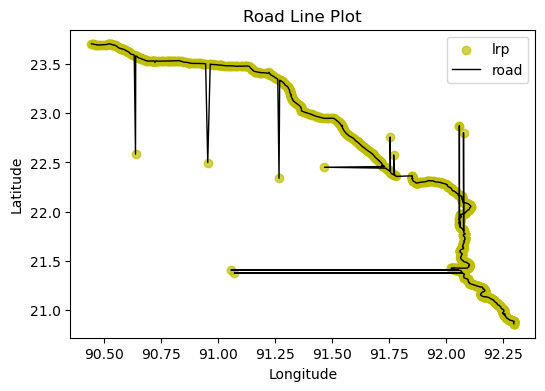

In [72]:
plot_road(n1)

In [74]:
n1_distance = calc_lrp_distance(n1)
n1_distance

0            NaN
1       0.799892
2       0.016446
3       0.168438
4       0.996024
          ...   
1343    0.047136
1344    0.426175
1345    0.040566
1346    0.188773
1347    0.006171
Length: 1348, dtype: float64

In [75]:
n1_distance.describe()

count    1347.000000
mean        1.614110
std        11.224575
min         0.000000
25%         0.096058
50%         0.249108
75%         0.515174
max       112.164894
dtype: float64

In [76]:
# show top 200 distances (in km)
n1_distance.sort_values(ascending=False).head(200).to_list()

[112.16489375714255,
 112.08441437160523,
 112.0087043059964,
 111.84809500232126,
 111.47700336655743,
 111.18257288820872,
 111.10174407943913,
 111.09300290708484,
 110.85863086392966,
 110.69454951156331,
 103.63267655989584,
 103.57033187718115,
 103.54114116394608,
 103.39313940166666,
 39.49608379624209,
 38.918224325595716,
 27.74376124401573,
 27.125807648886163,
 23.038966768680577,
 22.223543285391138,
 7.107518186328391,
 5.622637799532268,
 4.949499908051397,
 2.692918064377957,
 2.240435407390811,
 2.023108308817395,
 1.976484026894498,
 1.8248522247377519,
 1.7239979292354108,
 1.5465009847920486,
 1.3998743694287006,
 1.3874280799601384,
 1.364573013892594,
 1.3043723963688225,
 1.2572227698060774,
 1.2480611370518657,
 1.030188124767654,
 1.0248601084516646,
 1.0182196949423532,
 1.013018308134543,
 1.0052186576930964,
 1.0017244225249482,
 1.0016599132536657,
 1.0008212223406654,
 1.000559779399317,
 0.9998133978173757,
 0.9995792759710141,
 0.9995539775599125,
 0.999

In [77]:
n1_distance.quantile(0.85)

0.7373778727372169

In [78]:
n1_offroad = get_lrp_offroad(n1_distance)
n1_offroad

1       0.799892
4       0.996024
6       0.855933
7       0.981762
9       0.818548
          ...   
1259    0.883380
1262    0.821512
1276    1.546501
1277    1.976484
1342    0.803492
Length: 202, dtype: float64

In [79]:
n1_to_change = n1.loc[n1_offroad.index.to_list()]
n1_to_change

,road,lrp,lat,lon
1,N1,LRPSa,23.702917,90.450417
4,N1,LRP002,23.697889,90.460583
6,N1,LRP003,23.693833,90.469138
7,N1,LRP004,23.693611,90.478777
9,N1,LRP005,23.694750,90.488500
...,...,...,...,...
1259,N1,LRP450a,20.977805,92.250750
1262,N1,LRP451a,20.969722,92.248555
1276,N1,LRP454a,20.966028,92.257917
1277,N1,LRP454b,20.948277,92.258917


In [80]:
len(n1_offroad)

202

In [81]:
n1_copy = n1.copy()

In [82]:
n1_neo = fix_offroad_lrp(n1_copy, n1_offroad)
n1_neo

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\1303477288.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.704403,90.446903
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.699750,90.456819
...,...,...,...,...
1343,N1,LRP466a,20.868860,92.298222
1344,N1,LRP466b,20.865028,92.298250
1345,N1,LRP466c,20.864667,92.298194
1346,N1,LRP467,20.862972,92.298083


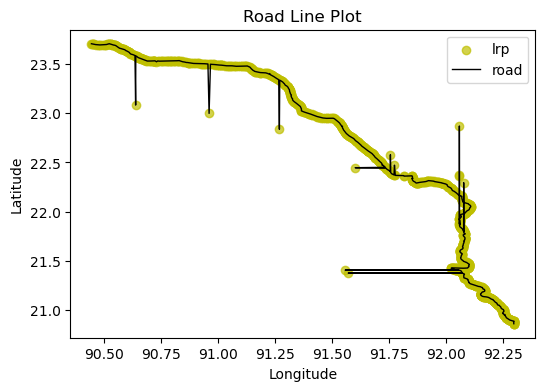

In [85]:
plot_road(n1_neo)

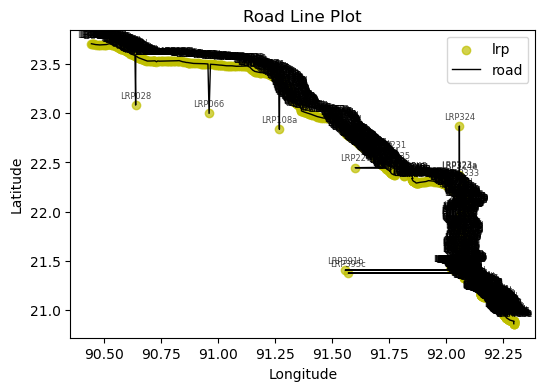

In [86]:
plot_roadname(n1_neo)

unfixed outlier: LRP324 and LRP323a, and LRP333.

So, check are the unfixed lrps even detected as offroad?

In [87]:
lrp_name = ['LRP324','LRP323a','LRP333']
outliers = n1_neo[n1_neo['lrp'].isin(lrp_name)]

outliers

,road,lrp,lat,lon
792,N1,LRP323a,22.374958,92.059111
793,N1,LRP324,22.870499,92.059139
818,N1,LRP333,22.295153,92.078083


In [88]:
lrp_index = [789, 790, 791, 792, 793, 794, 795, 796, 816, 817, 818, 819, 820]
rows = n1_neo.iloc[lrp_index]
rows

,road,lrp,lat,lon
789,N1,LRP322,21.888389,92.060083
790,N1,LRP322a,21.883902,92.059583
791,N1,LRP323,21.879416,92.059083
792,N1,LRP323a,22.374958,92.059111
793,N1,LRP324,22.870499,92.059139
794,N1,LRP324a,22.366069,92.059375
795,N1,LRP325,21.861639,92.059611
796,N1,LRP325a,21.859722,92.060278
816,N1,LRP331c,21.803028,92.077277
817,N1,LRP332,21.798611,92.077833


see index 792 and 793, and 818

In [89]:
n1_neo

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.704403,90.446903
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.699750,90.456819
...,...,...,...,...
1343,N1,LRP466a,20.868860,92.298222
1344,N1,LRP466b,20.865028,92.298250
1345,N1,LRP466c,20.864667,92.298194
1346,N1,LRP467,20.862972,92.298083


In [90]:
n1_neo1 = n1_neo.copy()

In [91]:
n1_neo_distance = calc_lrp_distance(n1_neo1)

In [92]:
# show top distances (in km)
n1_neo_distance.sort_values(ascending=False).head(30).to_list()

[56.131875303046186,
 56.09008435949732,
 56.0900843214289,
 56.021400351854204,
 55.938010200949506,
 55.77134624412075,
 55.53261456314925,
 55.51891903090943,
 55.41236468365878,
 55.2129239194713,
 55.101717495480024,
 55.10171749495206,
 51.93904520649846,
 51.84745465325252,
 51.709183313616585,
 51.574895825647566,
 19.94901635138327,
 19.258371933552777,
 13.886763737197287,
 13.552129847920993,
 11.525330126230525,
 11.111750755707426,
 3.785131557879199,
 3.5403478827941437,
 2.9507717653647836,
 2.3348246934691477,
 1.3516182853706622,
 1.240086340254266,
 1.1945222595080627,
 1.1326586499750797]

In [93]:
n1_neo_distance.quantile(0.99)

51.783849837019986

In [94]:
n1_neo_offroad = get_lrp_offroad(n1_neo_distance)
n1_neo_offroad

6       0.895692
9       0.907066
10      0.901985
18      0.715823
31      0.919089
          ...   
1257    0.722790
1277    0.767498
1278    0.997205
1282    0.732079
1334    0.697531
Length: 202, dtype: float64

the consecutive 792 and 793 is not detected as offroad LRPs

In [95]:
def get_lrp_offroad2(lrp_distance):
    # set threshold
    threshold = lrp_distance.quantile(0.99)
    #print(threshold)

    # both edges before and after the lrp are >>>
    lrp_offroad = lrp_distance.loc[(lrp_distance > threshold) & (lrp_distance.shift(-1) > threshold)]

    return lrp_offroad

In [96]:
n1_neo_offroad2 = get_lrp_offroad2(n1_neo_distance)
n1_neo_offroad2

70     55.938010
155    55.771346
234    56.021400
792    55.101717
793    55.101717
794    56.090084
818    55.212924
dtype: float64

In [97]:
def fix_consecutive_offroad_lrp(df, offroad_lrp):
    for i in range(0, len(offroad_lrp.index), 2):
        # first offroad lrp
        lrp_start_index = offroad_lrp.index[i]
        # first lrp on road again after a series of offroad lrps
        lrp_end_index = offroad_lrp.index[i + 1]
        # amount of offroad lrps
        total_offroad_lrp = lrp_end_index - lrp_start_index

        # the first and last lrp still on the road
        lrp_before = df.iloc[lrp_start_index - 1]
        lrp_after = df.iloc[lrp_end_index]

        # interpolate the lat and lon values for the offroad lrps
        lat_interval = (lrp_after['lat'] - lrp_before['lat']) / (total_offroad_lrp + 1)
        lon_interval = (lrp_after['lon'] - lrp_before['lon']) / (total_offroad_lrp + 1)

        for j in range(total_offroad_lrp):
            df.loc[lrp_start_index + j, 'lat'] = lrp_before['lat'] + lat_interval * (j + 1)
            df.loc[lrp_start_index + j, 'lon'] = lrp_before['lon'] + lon_interval * (j + 1)
        
    return df

In [98]:
n1_new = fix_offroad_lrp(n1_neo, n1_neo_offroad2)

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\1303477288.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])

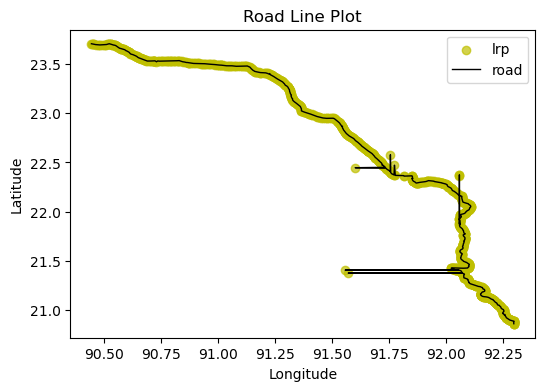

In [99]:
plot_road(n1_new)

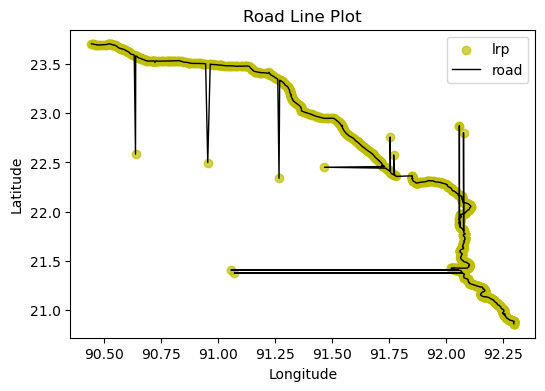

In [102]:
plot_road(n1)

In [103]:
n1_new_distance = calc_lrp_distance(n1_new)
n1_new_distance

0            NaN
1       0.405872
2       0.405876
3       0.168438
4       0.560483
          ...   
1343    0.425056
1344    0.426175
1345    0.040566
1346    0.188773
1347    0.006171
Length: 1348, dtype: float64

In [104]:
# show top 10 distances (in km)
n1_new_distance.sort_values(ascending=False).head(10).to_list()

[56.09008435949732,
 55.101717495480024,
 51.93904520649846,
 51.84745465325252,
 51.709183313616585,
 51.574895825647566,
 19.94901635138327,
 19.258371933552777,
 13.886763737197287,
 13.552129847920993]

In [105]:
def get_consecutive_offroads(df, quantile=0.9, similarity_threshold=0.10, max_group_size=10):
    df['distance'] = calc_lrp_distance(df) # distance to the previous LRP
    threshold = df['distance'].quantile(quantile)

    offroad_lrp_index = df.index[df['distance'] > threshold].tolist()

    # List to store groups of consecutive outliers
    offroad_groups = []
    checked = set()

    for idx in offroad_lrp_index:
        if idx in checked:
            continue

        group = [idx] # assign the index to a new group

        # check the next max_group_size rows for similar lrp_distance values
        for offset in range(1, max_group_size + 1):
            next_idx = idx + offset
            if next_idx in df.index and next_idx not in checked: # get the distance
                ref_distance = df.at[idx, 'distance']
                next_distance = df.at[next_idx, 'distance']

                # check if the next lrp_distance is within similarity threshold
                if abs(ref_distance - next_distance) <= next_distance * similarity_threshold:
                    group.append(next_idx)
                    break
                else:
                    continue

        # only store in groups if there is 2 or more LRP with similar distance
        if 1 < len(group) <= max_group_size:
            offroad_groups.append(group)
            checked.update(group)  # mark indices as checked

    # check if there are any groups before concatenating
    if offroad_groups:
        # consecutive offroads df
        offroad_df = df.loc[np.concatenate(offroad_groups)].copy()
        offroad_df['offroad_group'] = np.repeat(range(1, len(offroad_groups) + 1), [len(g) for g in offroad_groups])
    else:
        offroad_df = pd.DataFrame(columns=df.columns)

    return offroad_df

In [106]:
n1_new_offroad = get_consecutive_offroads(n1_new)

In [107]:
n1_new_offroad

,road,lrp,lat,lon,distance,offroad_group
6,N1,LRP003,23.695486,90.470222,0.895692,1
9,N1,LRP005,23.694861,90.489361,0.907066,1
110,N1,LRP041,23.530860,90.734472,1.043317,2
115,N1,LRP044,23.529930,90.761527,0.998442,2
128,N1,LRP050,23.533152,90.817444,0.785654,3
...,...,...,...,...,...,...
995,N1,LRP391c,21.405861,92.059417,51.939045,48
1017,N1,LRP395c,21.376902,91.571083,51.709183,49
1018,N1,LRP395d,21.376222,92.071805,51.847455,49
1277,N1,LRP454b,20.957083,92.258611,0.767498,50


In [111]:
def interpolate_consecutive_offroads(df, offroad_df, max_lrp=5):
    if 'offroad_group' not in offroad_df.columns:
        return df  # No offroad groups to process
        
    for group_id, group in offroad_df.groupby('offroad_group'):
        # last right lrp before outliers
        start_index = group.index[0] - 1
        # first right lrp after outliers
        end_index = group.index[-1] + 1

        # ensure start and end indices are valid
        if start_index < 0 or end_index >= len(df):
            continue 

        start_point = df.loc[start_index, ['lat', 'lon']].values
        end_point = df.loc[end_index, ['lat', 'lon']].values

        # interpolate
        total_lrp = end_index - start_index + max_lrp
        lat_interp = np.linspace(start_point[0], end_point[0], total_lrp)[1:-1]
        lon_interp = np.linspace(start_point[1], end_point[1], total_lrp)[1:-1]

        # assign interpolated values to outlier rows
        for i in range(start_index + 1, end_index):
            df.loc[i, 'lat'] = lat_interp[i - start_index - 1]
            df.loc[i, 'lon'] = lon_interp[i - start_index - 1]
    
    return df

In [113]:
n1_newest = interpolate_consecutive_offroads(n1_new, n1_new_offroad)

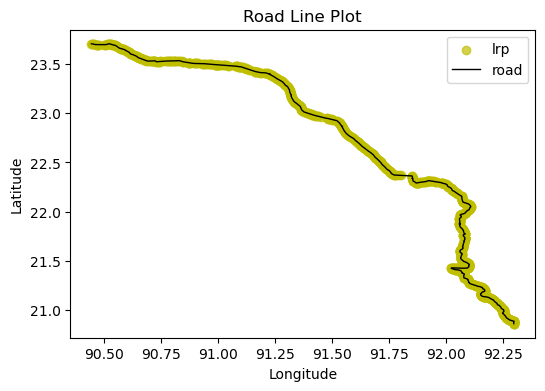

In [114]:
plot_road(n1_newest)

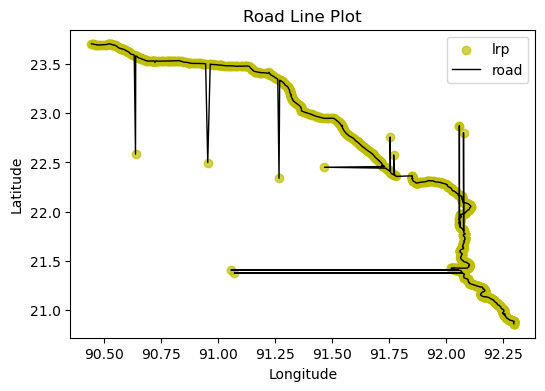

In [115]:
plot_road(n1)

In [116]:
def process_offroad_lrp(df):

    lrp_distance = calc_lrp_distance(df)
    lrp_offroad = get_lrp_offroad(lrp_distance)
    fixed_df = fix_offroad_lrp(df, lrp_offroad)

    return fixed_df

In [117]:
def process_offroad_lrp2(df):

    lrp_distance = calc_lrp_distance(df)
    lrp_offroad = get_lrp_offroad2(lrp_distance)
    fixed_df = fix_offroad_lrp(df, lrp_offroad)

    return fixed_df

In [118]:
def process_offroad_lrp3(df):

    lrp_offroad = get_consecutive_offroads(df)
    fixed_df = interpolate_consecutive_offroads(df, lrp_offroad)

    return fixed_df

In [121]:
def process_by_road(df, processing_function):
    # Group by 'road' column and apply the process_offroad_lrp function to each group
    processed_groups = df.groupby('road').apply(processing_function)
    
    # Reset the index to combine the groups back together
    processed_df = processed_groups.reset_index(drop=True)
    
    return processed_df

In [122]:
def plot_road_big(df):
    plt.figure(figsize=(16, 12))
    plt.scatter(df['lon'], df['lat'], color='y', alpha=0.7,
                label='lrp')
    plt.plot(df['lon'], df['lat'], color='k', alpha=1, linewidth=1,
            label='road')
        
    # Annotate each point with the 'lrp' label
    #for i, row in df.iterrows():
     #   plt.annotate(row['lrp'], (row['lon'], row['lat']), textcoords="offset points", xytext=(0, 5), ha='center')
        
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title('Road Line Plot')
    plt.legend()
    plt

    plt.show()

In [123]:
df_rd.head(5)

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.702917,90.450417
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.697889,90.460583


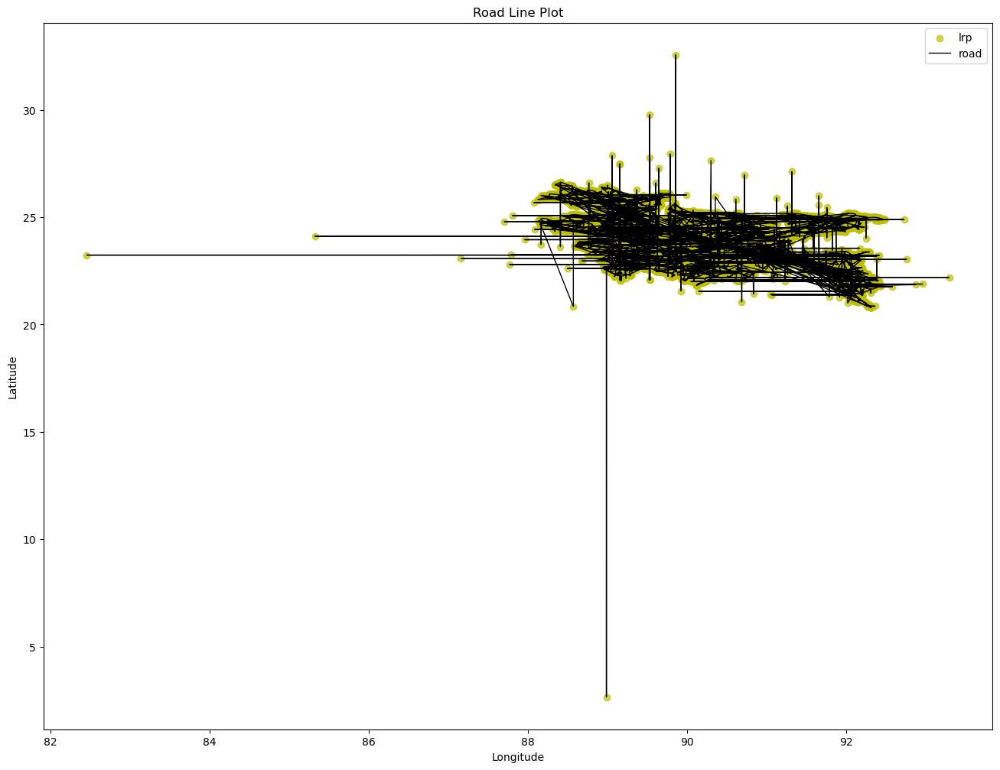

In [124]:
plot_road_big(df_rd)

In [125]:
df_rd1 = process_by_road(df_rd, process_offroad_lrp)

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\1303477288.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])

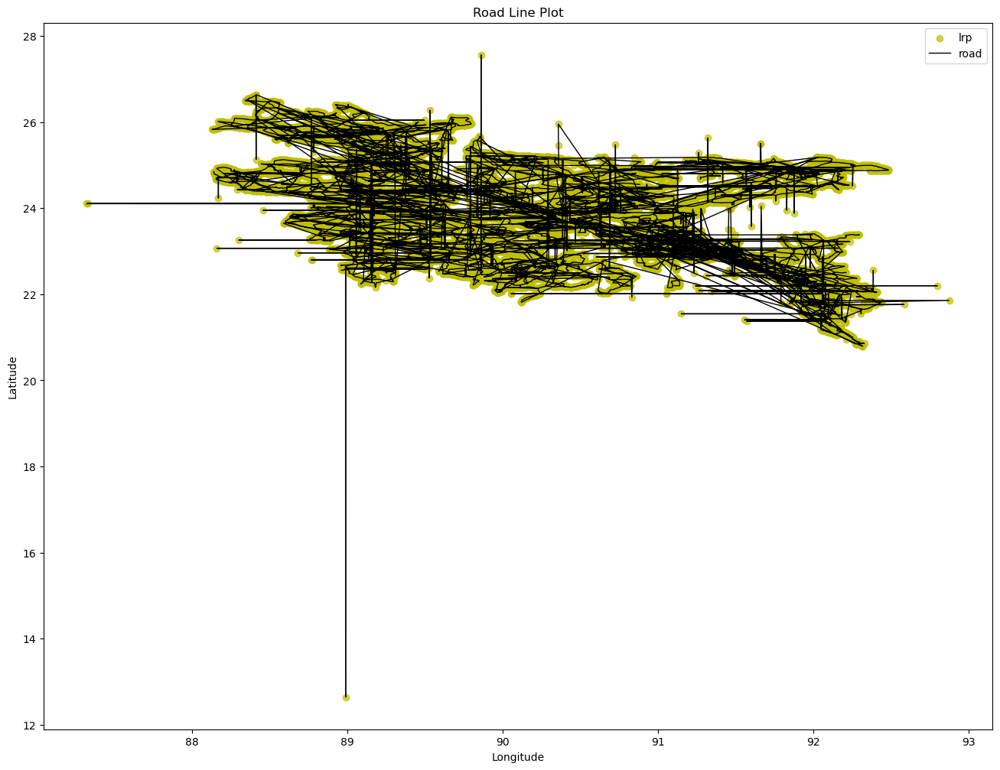

In [126]:
plot_road_big(df_rd1)

In [127]:
df_rd2 = process_by_road(df_rd1, process_offroad_lrp2)

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\1303477288.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])

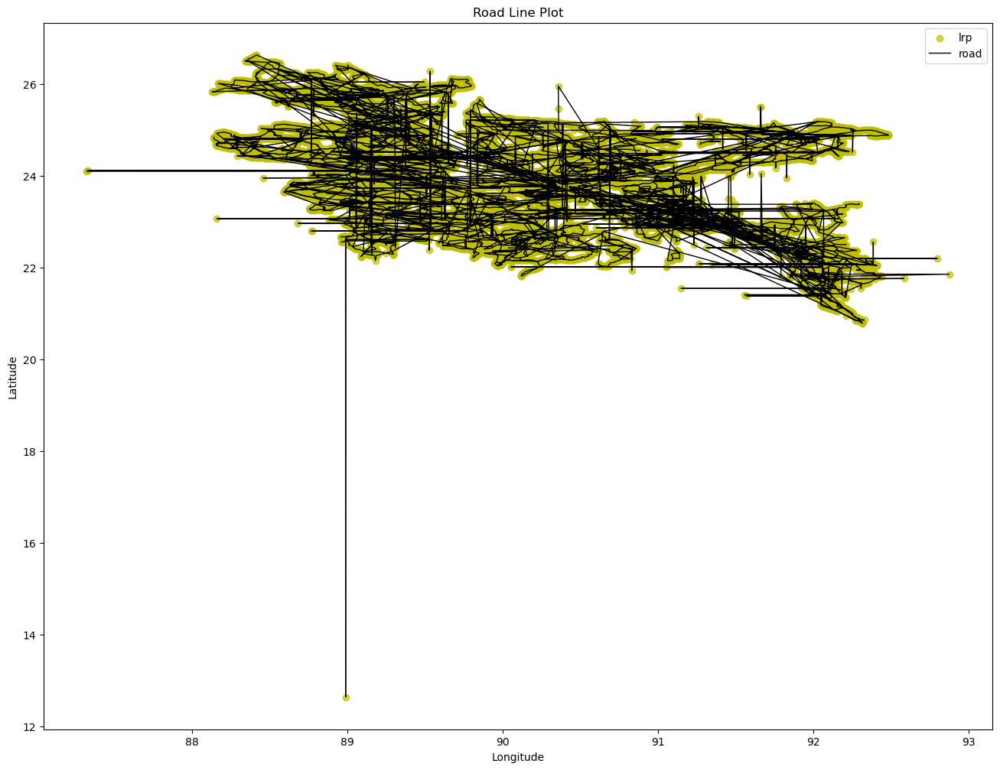

In [128]:
plot_road_big(df_rd2)

In [129]:
df_rd3 = process_by_road(df_rd2, process_offroad_lrp3)

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\3532550925.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  processed_groups = df.groupby('road').apply(processing_function)


In [130]:
df_rd4 = process_by_road(df_rd3, process_offroad_lrp)

C:\Users\Move\AppData\Local\Temp\ipykernel_13132\1303477288.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['lat'].loc[lrp_offroad.index] = 0.5 * (df['lat'].shift(1).loc[lrp_offroad.index] + df['lat'].shift(-1).loc[lrp_offroad.index])

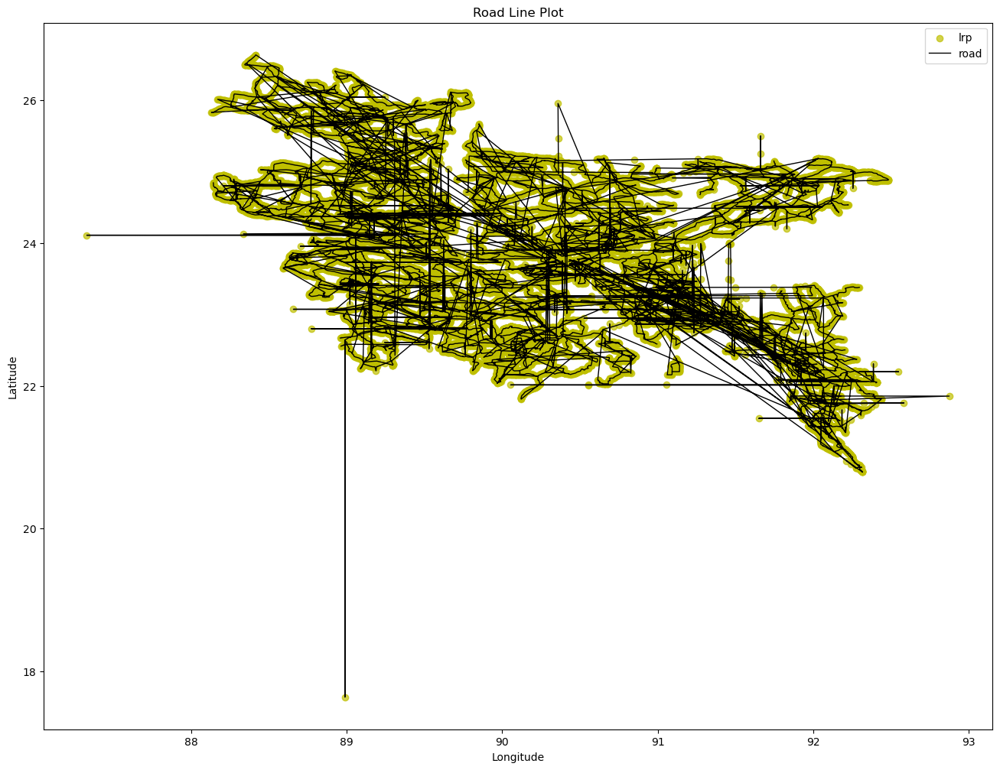

In [131]:
plot_road_big(df_rd4)

In [132]:
# Create a plot function
def plot_map(df_rd):
    plt.figure(figsize=(10, 10))

    for idx, (road, group) in enumerate(df_rd.groupby('road')):
        plt.plot(group['lon'], group['lat'], 'o-', markersize=3)

    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

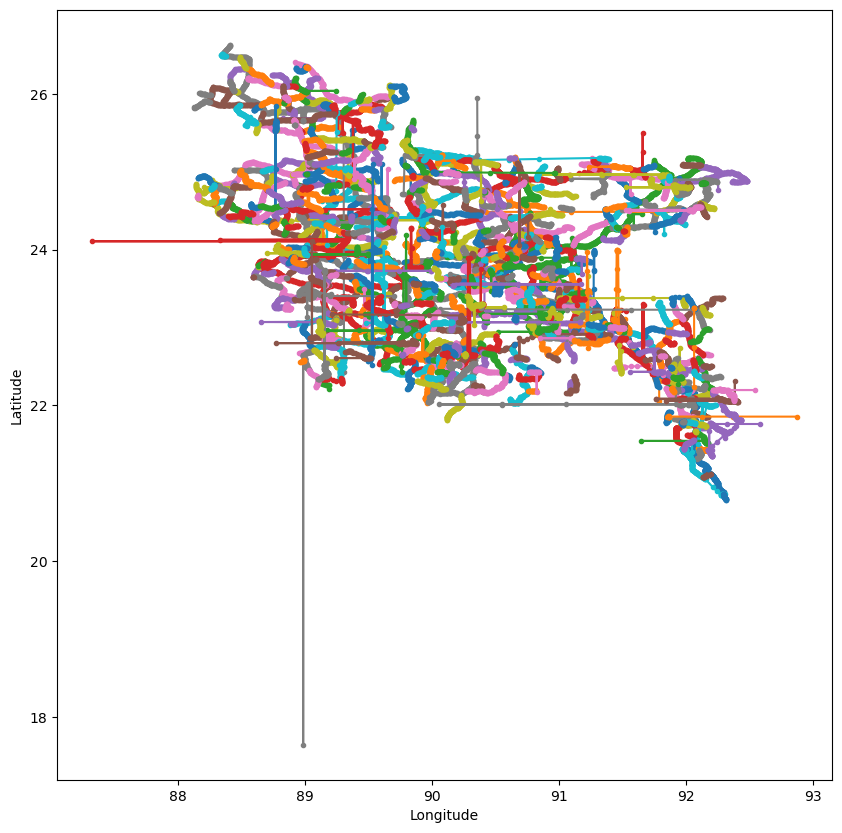

In [133]:
plot_map(df_rd4)

In [134]:
plot_roadname(df_rd4)

KeyboardInterrupt: 

---

# Move edit

In [148]:
# load the original data
df_rd = pd.read_csv('roads_transposed.csv')

In [149]:
df_rd

,road,lrp,lat,lon
0,N1,LRPS,23.706028,90.443333
1,N1,LRPSa,23.702917,90.450417
2,N1,LRPSb,23.702778,90.450472
3,N1,LRP001,23.702139,90.451972
4,N1,LRP002,23.697889,90.460583
...,...,...,...,...
52205,Z8943,LRP007,22.429499,90.785722
52206,Z8943,LRP008,22.430110,90.776333
52207,Z8943,LRP008a,22.430249,90.774888
52208,Z8943,LRP008b,22.430249,90.774860


In [240]:
# calcuate mean and sd; count the number of lrps, grouped by road
df_rd_stats = df_rd.groupby('road').agg({'lat': ['mean', 'std'], 'lon': ['mean', 'std'], 'lrp': 'count'})
df_rd_stats


lat                  lon             lrp
            mean       std       mean       std count
road                                                 
N1     22.210588  0.895495  91.738073  0.506549  1348
N101   23.460693  0.003543  91.232007  0.015241    17
N102   23.754127  0.211144  91.078499  0.058243   222
N103   23.977949  0.012642  91.111769  0.001700    12
N104   22.932367  0.047218  91.199221  0.102652   125
...          ...       ...        ...       ...   ...
Z8910  22.575794  0.077804  90.502111  0.038390    86
Z8913  22.352482  0.016737  90.753045  0.054525    51
Z8915  22.597001  0.006225  90.688336  0.042785    32
Z8916  22.653912  0.209799  90.706698  0.026299    23
Z8943  22.376736  0.223684  90.807325  0.026250    20

[877 rows x 5 columns]

In [241]:
# calculate min and max of sd for lat and lon
df_rd_stats['lat']['std'].min(), df_rd_stats['lat']['std'].max(), df_rd_stats['lon']['std'].min(), df_rd_stats['lon']['std'].max()

(3.372958289125104e-05,
 1.3377029252626567,
 0.00028798866239506077,
 1.397793061208363)

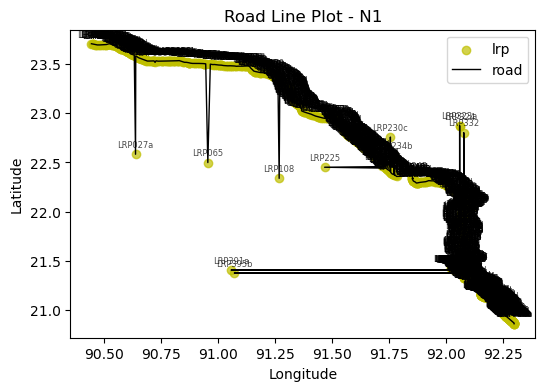

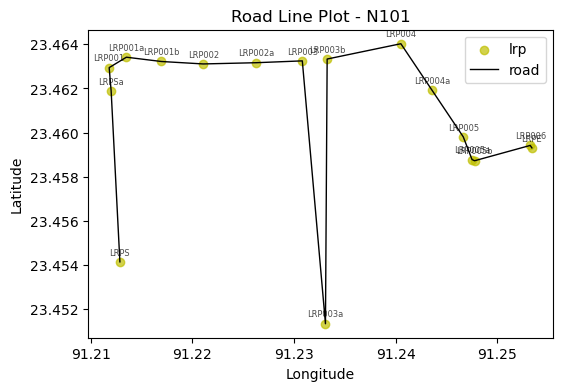

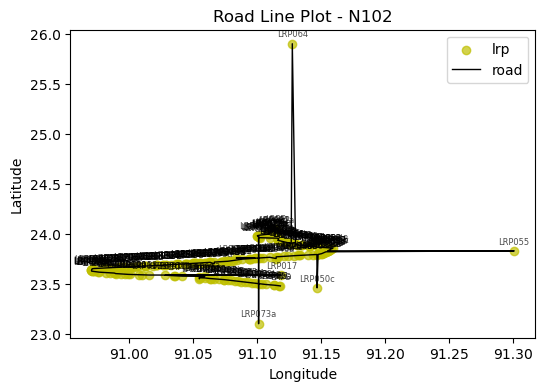

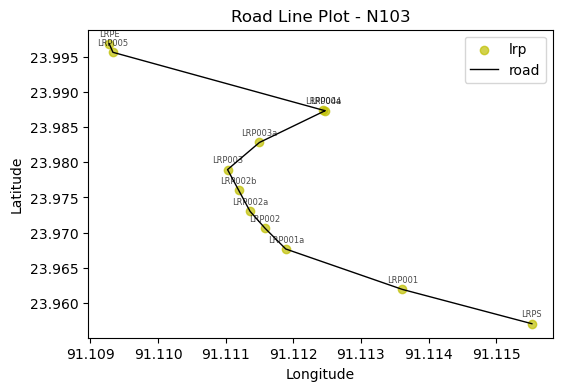

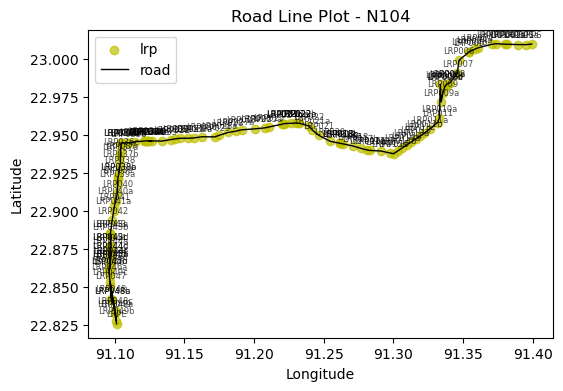

...

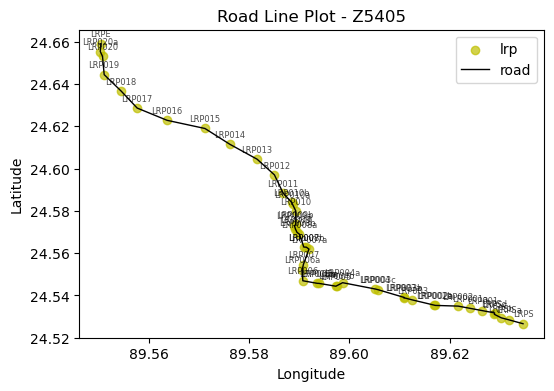

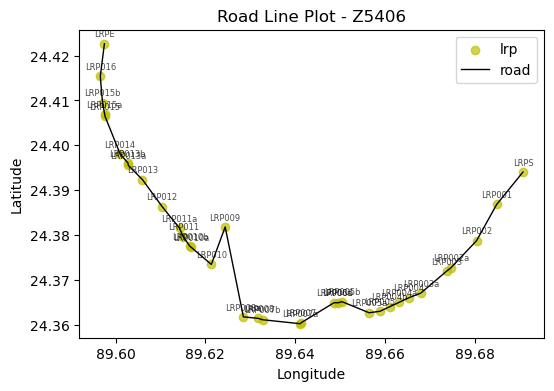

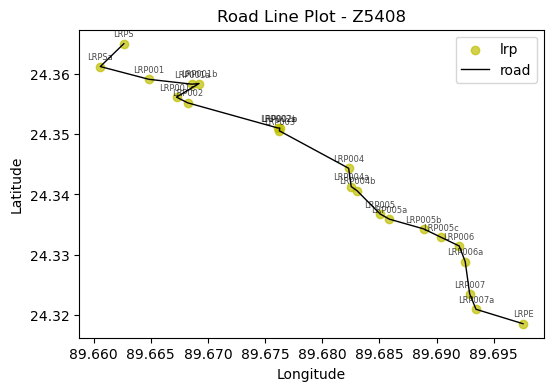

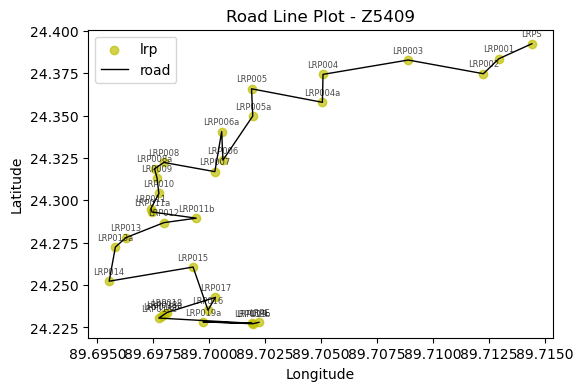

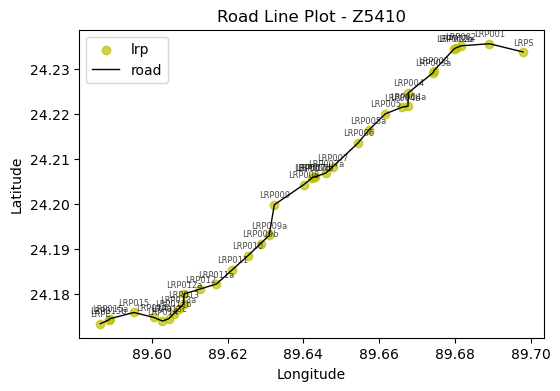

KeyboardInterrupt: 

In [238]:
# plot each road from df_rd in separate plots
def plot_road(df):
    plt.figure(figsize=(6, 4))
    plt.scatter(df['lon'], df['lat'], color='y', alpha=0.7,
                label='lrp')
    plt.plot(df['lon'], df['lat'], color='k', alpha=1, linewidth=1,
            label='road')
        
    # Annotate each point with the 'lrp' label
    for i, row in df.iterrows():
        plt.annotate(row['lrp'], (row['lon'], row['lat']), textcoords="offset points", xytext=(0, 5), 
                     ha='center', fontsize=6, alpha=0.7)
        
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(f'Road Line Plot - {df["road"].iloc[0]}')
    plt.legend()
    plt

    plt.show()

for road, group in df_rd.groupby('road'):
    plot_road(group)

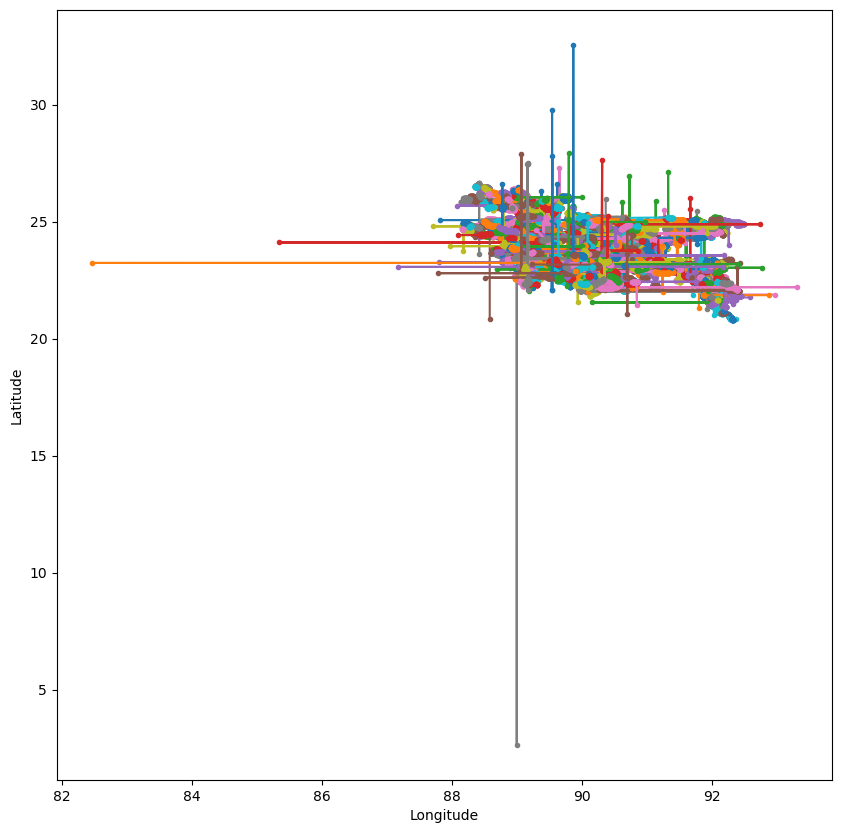

In [155]:
# plot the original data
plot_map(df_rd)

In [ ]:
import pandas as pd
import numpy as np

# Haversine formula to calculate distance between two points
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in km
    dlat = np.radians(lat2 - lat1)
    dlon = np.radians(lat2 - lon1)
    a = np.sin(dlat / 2) ** 2 + np.cos(np.radians(lat1)) * np.cos(np.radians(lat2)) * np.sin(dlon / 2) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    return R * c

# Function to detect outliers based on distance threshold
def detect_outliers(df, threshold=1.0):
    outliers = []
    for i in range(1, len(df) - 1):
        d1 = haversine(df.iloc[i-1]['lat'], df.iloc[i-1]['lon'], df.iloc[i]['lat'], df.iloc[i]['lon'])
        d2 = haversine(df.iloc[i]['lat'], df.iloc[i]['lon'], df.iloc[i+1]['lat'], df.iloc[i+1]['lon'])
        if d1 > threshold or d2 > threshold:
            outliers.append(i)
    print(f'Found {len(outliers)} outliers in road segment')
    return outliers
'''
# Function to detect outliers based on quantile on distances between lrps
def detect_outliers(df, window_size=5, quantile=0.95):
    distances = []
    for i in range(len(df)):
        if i < window_size or i >= len(df) - window_size:
            continue
        window_distances = []
        for j in range(-window_size, window_size + 1):
            if j == 0:
                continue
            d = haversine(df.iloc[i]['lat'], df.iloc[i]['lon'], df.iloc[i + j]['lat'], df.iloc[i + j]['lon'])
            window_distances.append(d)
        distances.append((i, np.mean(window_distances)))
    
    if len(distances) == 0:
        return []
    
    indices, mean_distances = zip(*distances)
    threshold = np.quantile(mean_distances, quantile)
    outliers = [indices[i] for i, d in enumerate(mean_distances) if d > threshold]
    print(f'Found {len(outliers)} outliers in road segment')
    return outliers
'''
# Function to pull outliers back to a position near the closest non-outlier points
def pull_back_outliers(df, outliers):
    i = 0
    while i < len(outliers):
        start = outliers[i] - 1
        end = outliers[i]
        while i + 1 < len(outliers) and outliers[i + 1] == outliers[i] + 1:
            end = outliers[i + 1]
            i += 1
        end += 1
        lat_before = df.iloc[start]['lat']
        lon_before = df.iloc[start]['lon']
        lat_after = df.iloc[end]['lat']
        lon_after = df.iloc[end]['lon']
        for j in range(start + 1, end):
            ratio = (j - start) / (end - start)
            df.at[j, 'lat'] = lat_before + ratio * (lat_after - lat_before)
            df.at[j, 'lon'] = lon_before + ratio * (lon_after - lon_before)
        i += 1
    return df

# Example usage
df_rd = pd.read_csv('roads_transposed.csv')  # Load your data
roads = df_rd['road'].unique()

# Make a copy of the original data before fixing
df_rd_original = df_rd.copy()

for road in roads:
    df_road = df_rd[df_rd['road'] == road].reset_index(drop=True)
    outliers = detect_outliers(df_road)
    df_road_corrected = pull_back_outliers(df_road, outliers)
    df_rd.loc[df_rd['road'] == road, ['lat', 'lon']] = df_road[['lat', 'lon']].values

# Save the corrected dataframe
#df_rd.to_csv('roads_corrected.csv', index=False)

Found 1346 outliers in road segment
Found 15 outliers in road segment
Found 220 outliers in road segment
Found 10 outliers in road segment
Found 123 outliers in road segment
Found 119 outliers in road segment
Found 212 outliers in road segment
Found 30 outliers in road segment
Found 92 outliers in road segment
Found 10 outliers in road segment
Found 29 outliers in road segment
Found 43 outliers in road segment
Found 8 outliers in road segment
Found 2 outliers in road segment
Found 46 outliers in road segment
Found 17 outliers in road segment
Found 0 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 4 outliers in road segment
Found 7 outliers in road segment
Found 895 outliers in road segment
Found 3 outliers in road segment
Found 91 outliers in road segment
Found 6 outliers in road segment
Found 6 outliers in road segment
Found 165 outliers in road segment
Found 176 outliers in road segment
Found 5 outliers

Found 52208 outliers in road segment


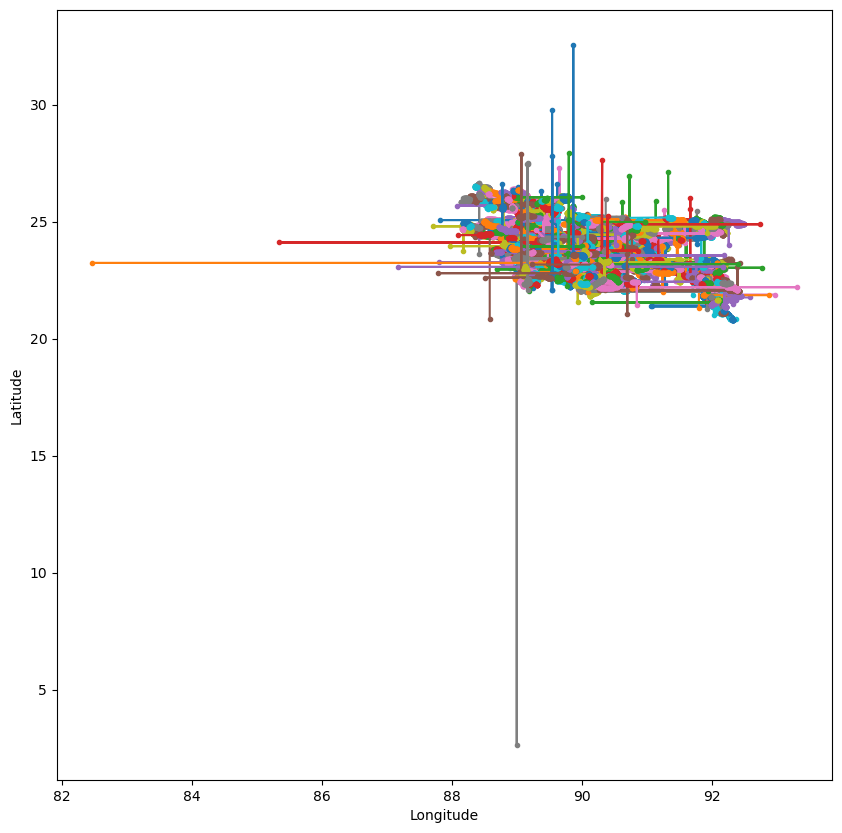

In [243]:
# Check outliers
detect_outliers(df_rd_original)
# Plot the original data
plot_map(df_rd_original)

Found 52208 outliers in road segment


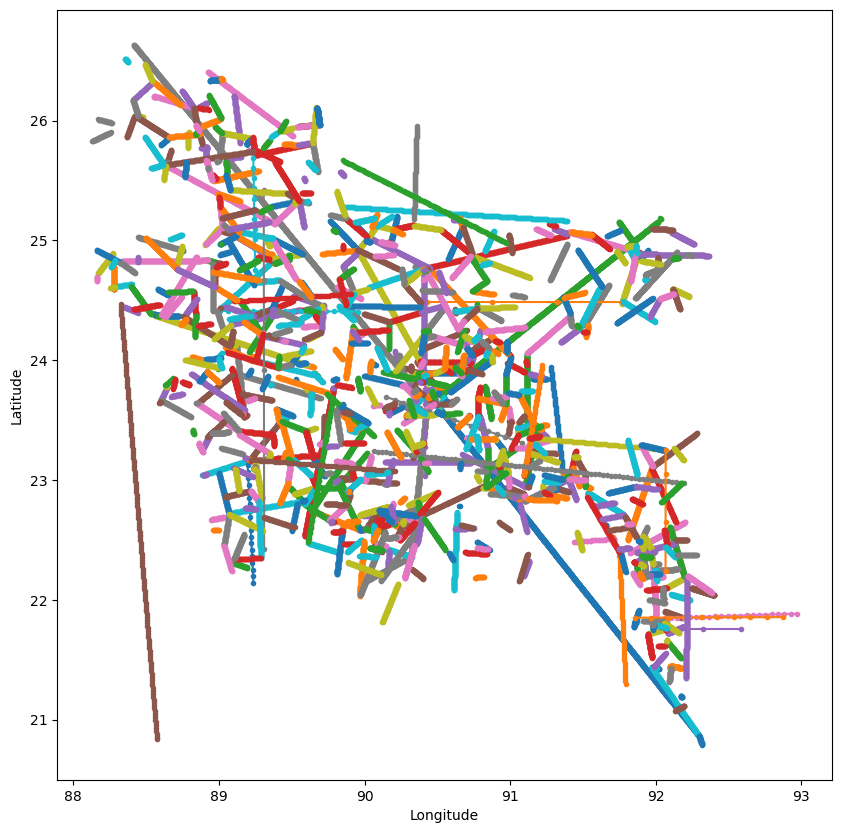

In [244]:
# Check outliers
detect_outliers(df_rd)
# Plot the corrected data
plot_map(df_rd)

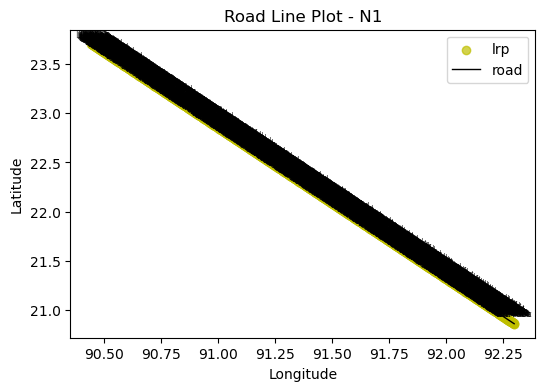

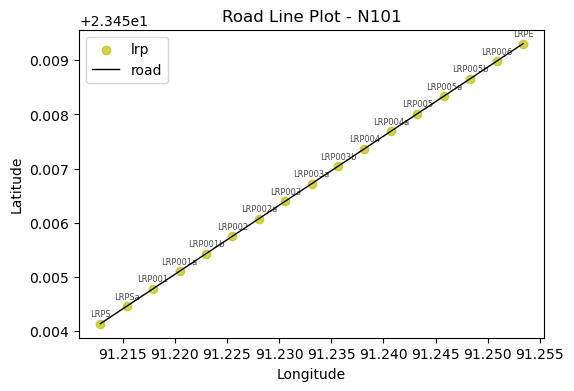

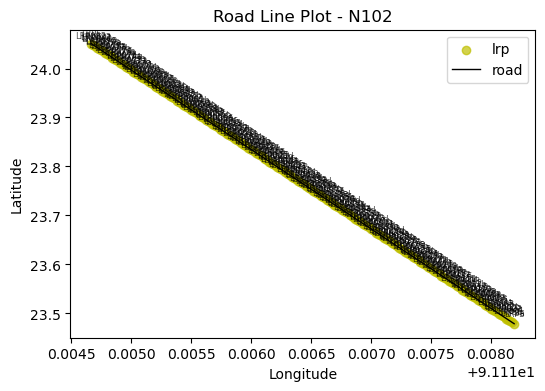

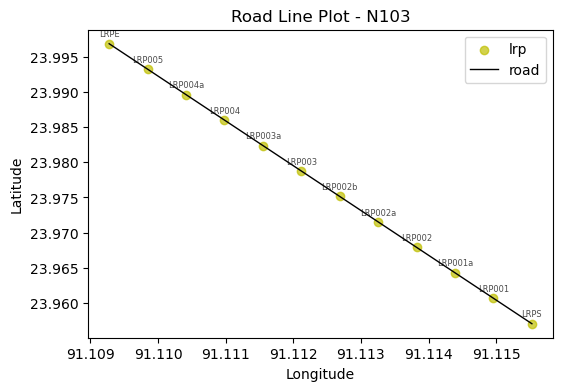

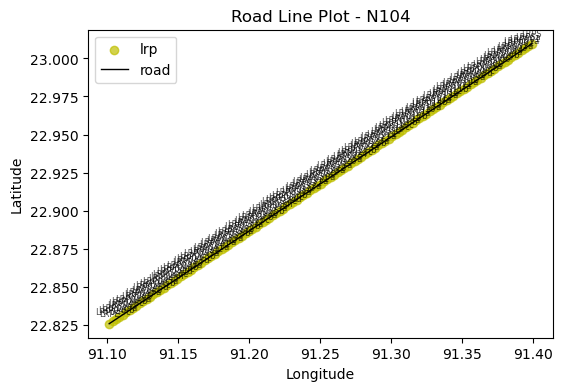

...

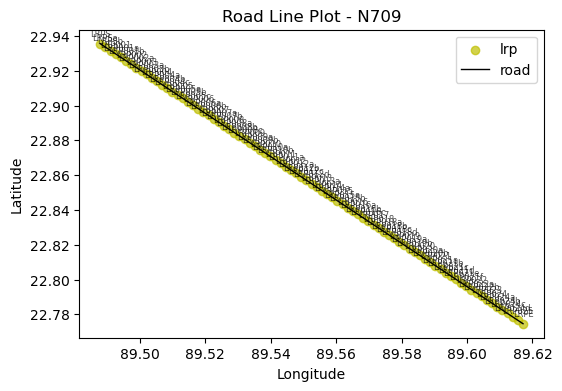

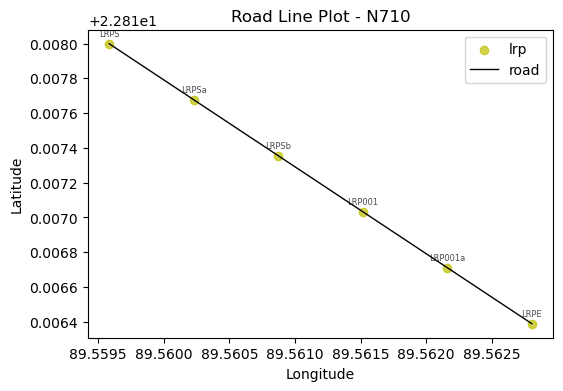

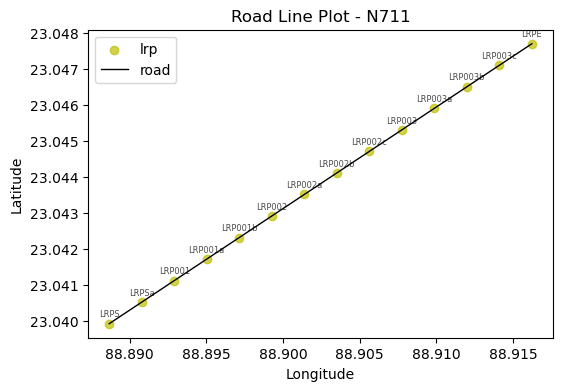

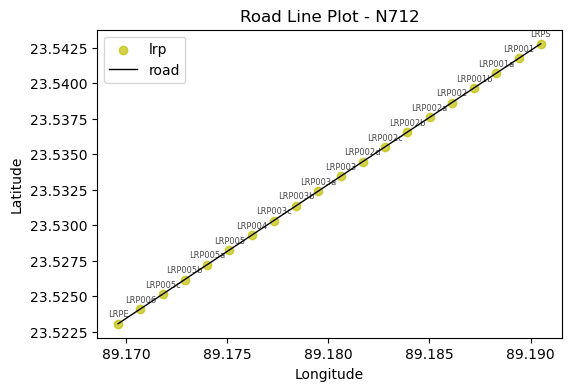

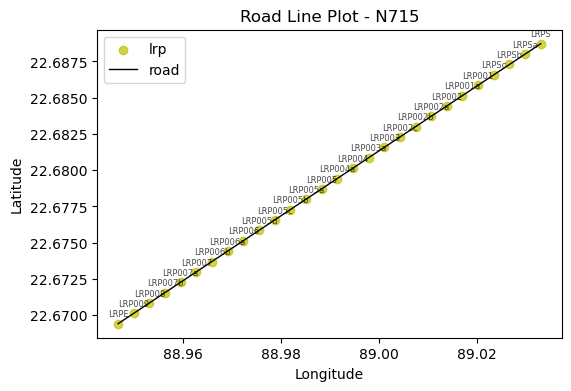

KeyboardInterrupt: 

In [245]:
for road, group in df_rd.groupby('road'):
    plot_road(group)

In [228]:
df_road

,road,lrp,lat,lon
0,Z8943,LRPS,22.426444,90.849472
1,Z8943,LRPSa,22.426416,90.846833
2,Z8943,LRP001,22.425444,90.839861
3,Z8943,LRP001a,21.426472,90.839305
4,Z8943,LRP002,22.424860,90.831610
5,Z8943,LRP002a,22.424263,90.826958
6,Z8943,LRP003,22.423666,90.822305
7,Z8943,LRP003a,22.423222,90.819138
8,Z8943,LRP003b,22.423972,90.813611
9,Z8943,LRP004,22.423999,90.813139


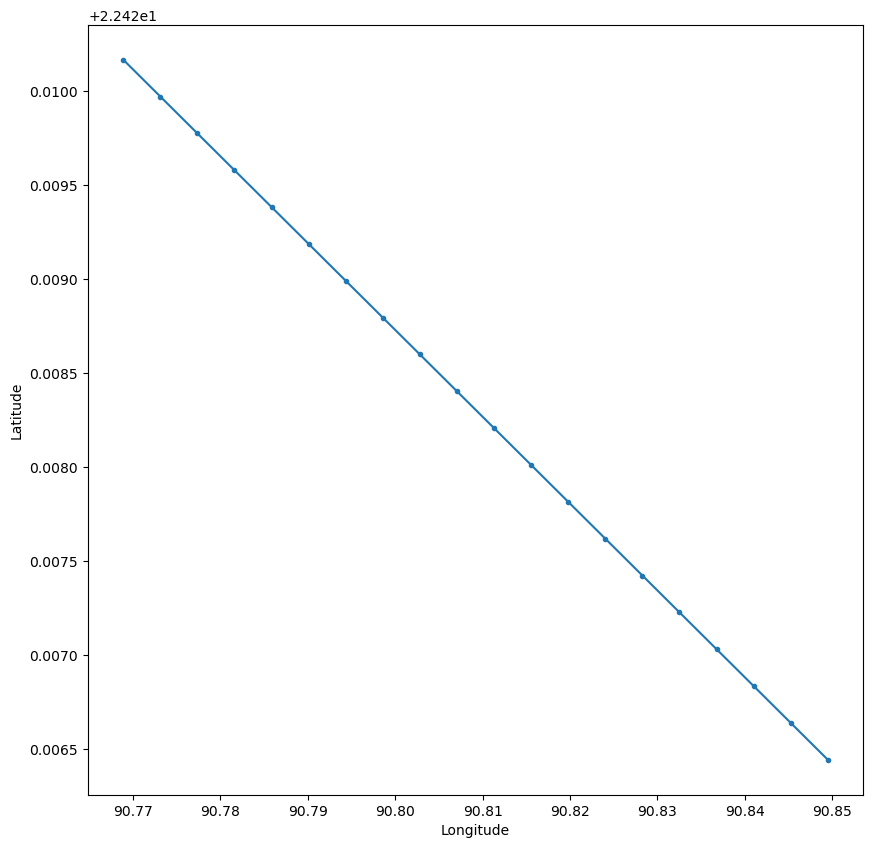

In [215]:
plot_map(df_road)

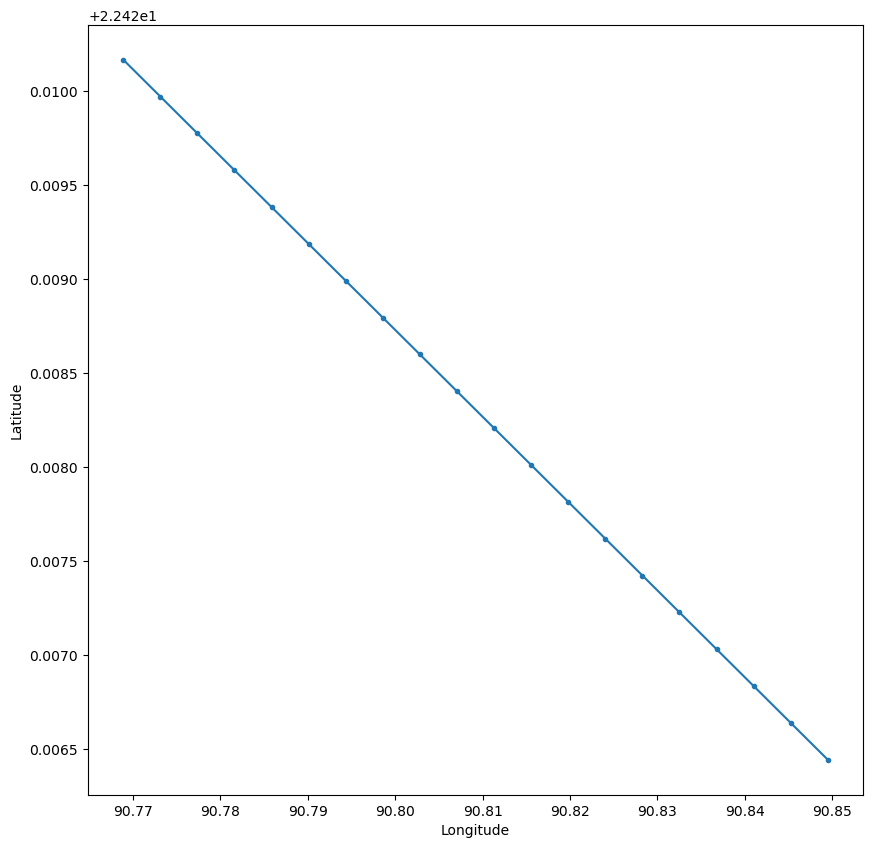

In [216]:
plot_map(df_rd[df_rd['road'] == 'Z8943'])

In [229]:
for i in range(10):
    for road in roads:
        df_road = df_rd[df_rd['road'] == road].reset_index(drop=True)
        outliers = detect_outliers(df_road)
        df_road_corrected = pull_back_outliers(df_road, outliers)
        df_rd.loc[df_rd['road'] == road, ['lat', 'lon']] = df_road[['lat', 'lon']].values

Found 67 outliers in road segment
Found 1 outliers in road segment
Found 11 outliers in road segment
Found 1 outliers in road segment
Found 6 outliers in road segment
Found 6 outliers in road segment
Found 11 outliers in road segment
Found 2 outliers in road segment
Found 5 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 2 outliers in road segment
Found 2 outliers in road segment
Found 1 outliers in road segment
Found 45 outliers in road segment
Found 5 outliers in road segment
Found 8 outliers in road segment
Found 9 outliers in road segment
Found 2 outliers in road segment
Found 14 outliers in road segment
Found 1 outliers in road segment
Found 2 outliers in road segment
Found 18 outliers in road segment
Found 5 outliers in road segment
Found 4 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 62 outliers in road segment
Found 1 outliers in road segment
Fou

Found 2610 outliers in road segment


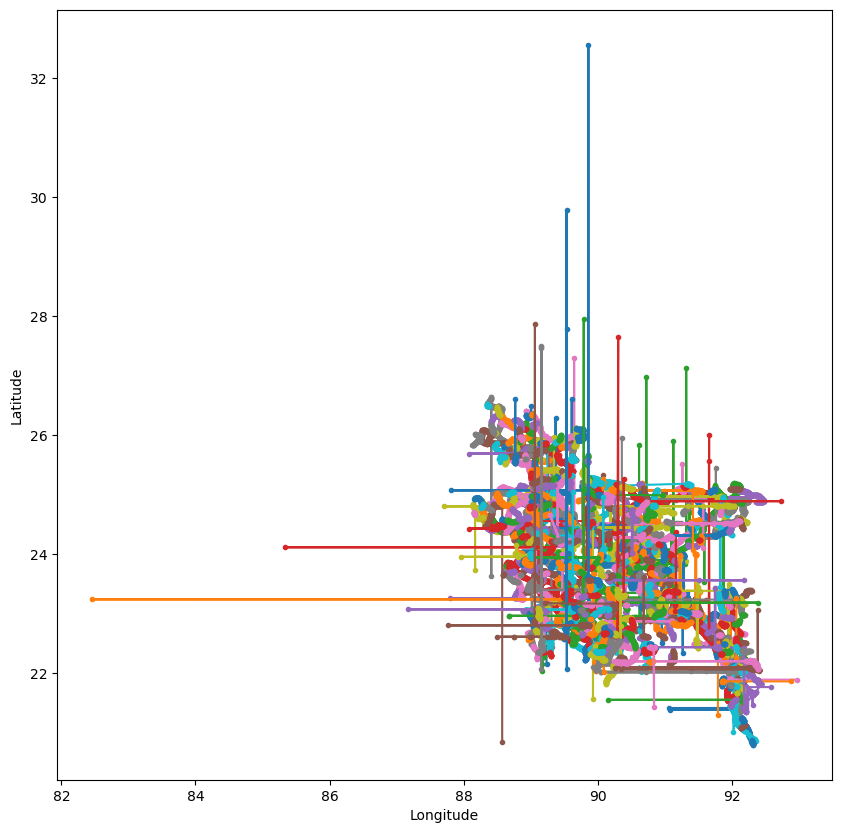

In [230]:
# Check outliers
detect_outliers(df_rd)
# Plot the corrected data
plot_map(df_rd)

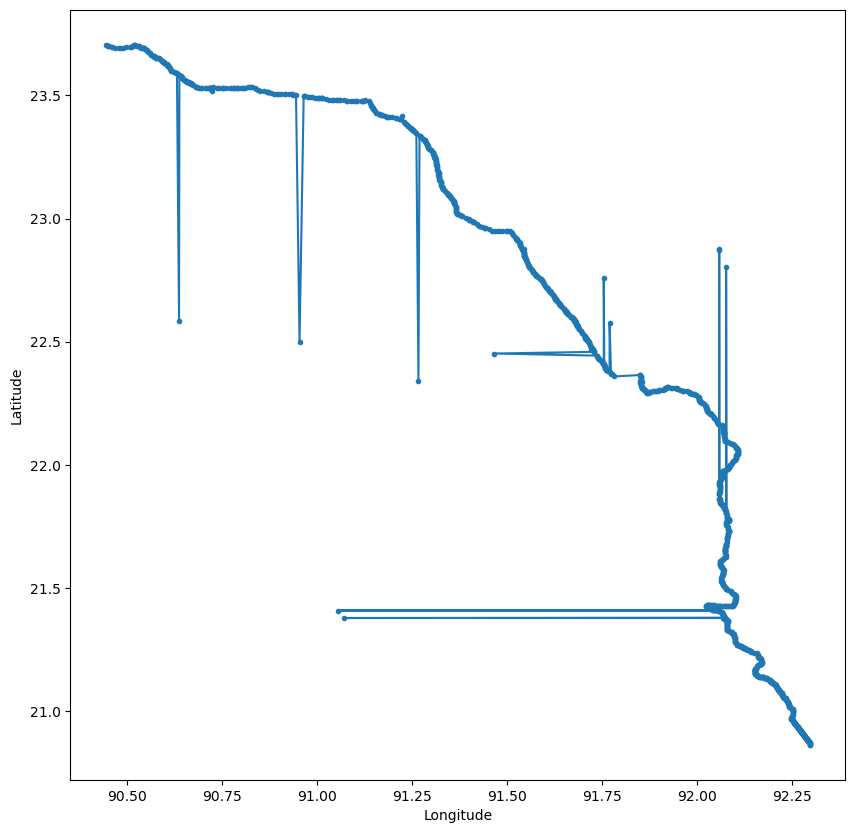

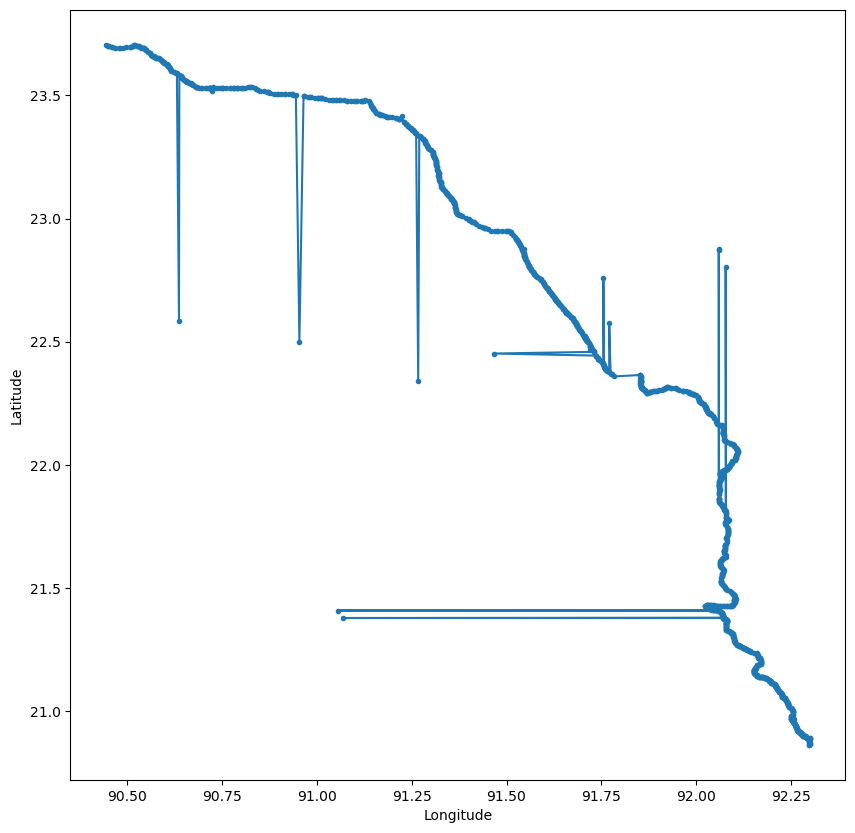

In [232]:
# plot 'N1' road from df_rd and df_rd_original
plot_map(df_rd[df_rd['road'] == 'N1'])
plot_map(df_rd_original[df_rd_original['road'] == 'N1'])

## code 2

In [251]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

# Haversine formula to calculate distance between two points
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Radius of the Earth in km
    dlat = np.radians(lat2 - lat1)
    dlon = np.radians(lat2 - lon1)
    a = np.sin(dlat / 2) ** 2 + np.cos(np.radians(lat1)) * np.cos(np.radians(lat2)) * np.sin(dlon / 2) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    return R * c

# Function to detect outliers based on latitude and longitude threshold
def detect_outliers(df, lat_threshold=0.005, lon_threshold=0.005):
    outliers = []
    for i in range(1, len(df) - 1):
        lat_diff1 = abs(df.iloc[i]['lat'] - df.iloc[i - 1]['lat'])
        lon_diff1 = abs(df.iloc[i]['lon'] - df.iloc[i - 1]['lon'])
        lat_diff2 = abs(df.iloc[i]['lat'] - df.iloc[i + 1]['lat'])
        lon_diff2 = abs(df.iloc[i]['lon'] - df.iloc[i + 1]['lon'])
        
        if lat_diff1 > lat_threshold or lon_diff1 > lon_threshold or lat_diff2 > lat_threshold or lon_diff2 > lon_threshold:
            outliers.append(i)
    print(f'Found {len(outliers)} outliers in road segment')
    return outliers

'''# Function to detect outliers based on quantile on distances between lrps
def detect_outliers(df, window_size=1, quantile=0.75):
    distances = []
    for i in range(len(df)):
        if i < window_size or i >= len(df) - window_size:
            continue
        window_distances = []
        for j in range(-window_size, window_size + 1):
            if j == 0:
                continue
            d = haversine(df.iloc[i]['lat'], df.iloc[i]['lon'], df.iloc[i + j]['lat'], df.iloc[i + j]['lon'])
            window_distances.append(d)
        distances.append((i, np.mean(window_distances)))
    
    if len(distances) == 0:
        return []
    
    indices, mean_distances = zip(*distances)
    threshold = np.quantile(mean_distances, quantile)
    outliers = [indices[i] for i, d in enumerate(mean_distances) if d > threshold]
    print(f'Found {len(outliers)} outliers in road segment')
    return outliers'''

# Function to pull outliers back to a position near the closest non-outlier points using spline interpolation
def pull_back_outliers(df, outliers):
    i = 0
    while i < len(outliers):
        start = outliers[i] - 1
        end = outliers[i]
        while i + 1 < len(outliers) and outliers[i + 1] == outliers[i] + 1:
            end = outliers[i + 1]
            i += 1
        end += 1
        
        # Get the non-outlier points before and after the outliers
        lat_before = df.iloc[start]['lat']
        lon_before = df.iloc[start]['lon']
        lat_after = df.iloc[end]['lat']
        lon_after = df.iloc[end]['lon']
        
        # Interpolate using spline
        x = [start, end]
        lat_y = [lat_before, lat_after]
        lon_y = [lon_before, lon_after]
        
        lat_spline = interp1d(x, lat_y, kind='linear')
        lon_spline = interp1d(x, lon_y, kind='linear')
        
        for j in range(start + 1, end):
            df.at[j, 'lat'] = lat_spline(j)
            df.at[j, 'lon'] = lon_spline(j)
        
        i += 1
    return df

# Function to plot each road from df_rd in separate plots
def plot_road(df):
    plt.figure(figsize=(6, 4))
    plt.scatter(df['lon'], df['lat'], color='y', alpha=0.7, label='lrp')
    plt.plot(df['lon'], df['lat'], color='k', alpha=1, linewidth=1, label='road')
    
    # Annotate each point with the 'lrp' label
    for i, row in df.iterrows():
        plt.annotate(row['lrp'], (row['lon'], row['lat']), textcoords="offset points", xytext=(0, 5), 
                     ha='center', fontsize=6, alpha=0.7)
    
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.title(f'Road Line Plot - {df["road"].iloc[0]}')
    plt.legend()
    plt.show()

# Example usage
df_rd = pd.read_csv('roads_transposed.csv')  # Load your data
roads = df_rd['road'].unique()

# Make a copy of the original data before fixing
df_rd_original = df_rd.copy()

for road in roads:
    df_road = df_rd[df_rd['road'] == road].reset_index(drop=True)
    outliers = detect_outliers(df_road)
    df_road_corrected = pull_back_outliers(df_road, outliers)
    df_rd.loc[df_rd['road'] == road, ['lat', 'lon']] = df_road[['lat', 'lon']].values

# Save the corrected dataframe
df_rd.to_csv('roads_corrected.csv', index=False)

'''# Plot each road
for road, group in df_rd.groupby('road'):
    plot_road(group)'''

Found 483 outliers in road segment
Found 9 outliers in road segment
Found 102 outliers in road segment
Found 6 outliers in road segment
Found 71 outliers in road segment
Found 46 outliers in road segment
Found 64 outliers in road segment
Found 8 outliers in road segment
Found 15 outliers in road segment
Found 4 outliers in road segment
Found 0 outliers in road segment
Found 6 outliers in road segment
Found 3 outliers in road segment
Found 2 outliers in road segment
Found 25 outliers in road segment
Found 10 outliers in road segment
Found 0 outliers in road segment
Found 1 outliers in road segment
Found 1 outliers in road segment
Found 0 outliers in road segment
Found 0 outliers in road segment
Found 0 outliers in road segment
Found 312 outliers in road segment
Found 1 outliers in road segment
Found 30 outliers in road segment
Found 3 outliers in road segment
Found 0 outliers in road segment
Found 87 outliers in road segment
Found 61 outliers in road segment
Found 0 outliers in road seg

"# Plot each road\nfor road, group in df_rd.groupby('road'):\n    plot_road(group)"

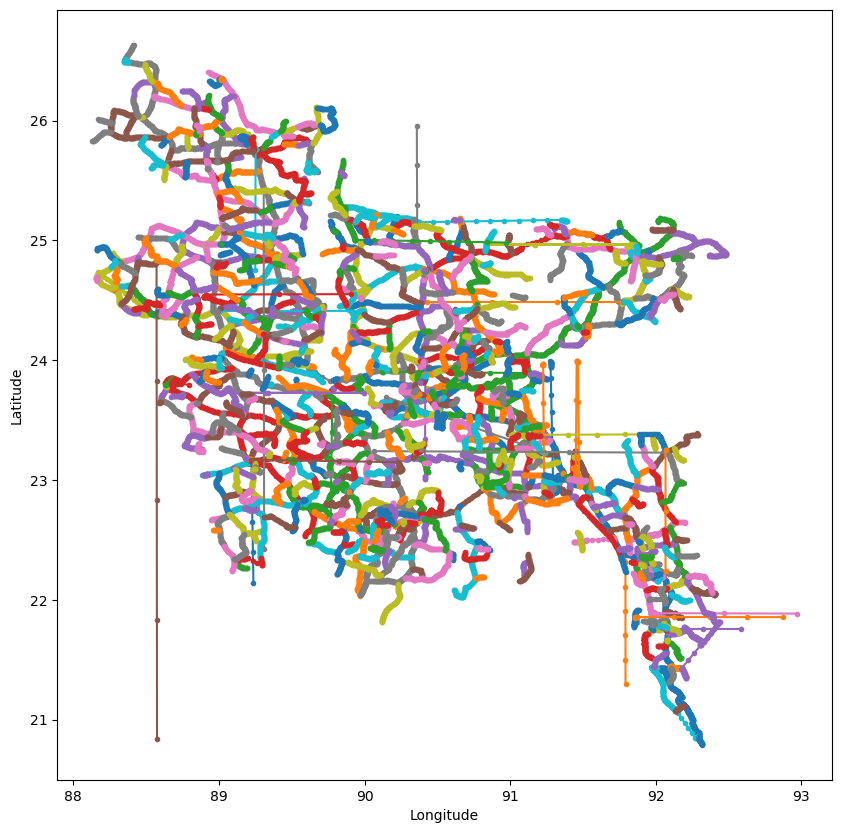

In [252]:
plot_map(df_rd)

In [253]:
detect_outliers(df_rd_original)

Found 25049 outliers in road segment


[1,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 17,
 18,
 30,
 31,
 32,
 33,
 34,
 45,
 46,
 47,
 48,
 53,
 54,
 60,
 61,
 62,
 63,
 64,
 65,
 68,
 69,
 70,
 76,
 77,
 92,
 93,
 97,
 98,
 99,
 100,
 101,
 102,
 107,
 108,
 109,
 110,
 111,
 112,
 114,
 115,
 116,
 117,
 118,
 120,
 121,
 123,
 124,
 126,
 127,
 128,
 129,
 131,
 132,
 134,
 135,
 136,
 137,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 153,
 154,
 155,
 157,
 158,
 159,
 160,
 161,
 162,
 164,
 165,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 183,
 184,
 186,
 187,
 188,
 189,
 190,
 191,
 192,
 193,
 197,
 198,
 199,
 200,
 205,
 206,
 209,
 210,
 211,
 212,
 213,
 215,
 216,
 217,
 218,
 219,
 221,
 222,
 224,
 225,
 226,
 227,
 230,
 231,
 232,
 233,
 234,
 237,
 238,
 240,
 241,
 243,
 244,
 252,
 253,
 254,
 255,
 260,
 261,
 267,
 268,
 275,
 276,
 277,
 278,
 279,
 280,
 284,
 285,
 289,
 290,
 291,
 292,
 295,
 296,
 297,
 298,
 299,
 300,
 303,
 304,

In [254]:
# Check outliers
detect_outliers(df_rd)


Found 8534 outliers in road segment


[2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 167,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 208,
 209,
 210,
 211,
 212,
 213,
 214,
 345,
 346,
 347,
 348,
 349,
 350,
 351,
 352,
 353,
 354,
 355,
 356,
 357,
 358,
 359,
 360,
 363,
 364,
 365,
 366,
 367,
 368,
 565,
 566,
 567,
 568,
 569,
 570,
 571,
 572,
 849,
 850,
 851,
 852,
 853,
 854,
 867,
 868,
 869,
 870,
 871,
 1347,
 1348,
 1364,
 1365,
 1579,
 1580,
 1581,
 1582,
 1583,
 1584,
 1585,
 1586,
 1587,
 1598,
 1599,
 1600,
 1601,
 1602,
 1603,
 1604,
 1605,
 1606,
 1607,
 1630,
 1631,
 1632,
 1633,
 1634,
 1651,
 1652,
 1653,
 1654,
 1655,
 1656,
 1657,
 1658,
 1659,
 1660,
 1661,
 1662,
 1663,
 1664,
 1665,
 1723,
 1724,
 1751,
 1752,
 1753,
 

In [255]:
# Check outliers
detect_outliers(df_rd4)

Found 18137 outliers in road segment


[9,
 10,
 11,
 30,
 31,
 32,
 33,
 34,
 96,
 97,
 99,
 100,
 101,
 108,
 109,
 110,
 115,
 116,
 117,
 118,
 123,
 124,
 129,
 130,
 131,
 132,
 136,
 137,
 138,
 142,
 143,
 144,
 148,
 149,
 150,
 153,
 154,
 155,
 159,
 160,
 161,
 177,
 178,
 179,
 182,
 183,
 184,
 199,
 200,
 201,
 207,
 208,
 209,
 210,
 211,
 212,
 216,
 217,
 218,
 219,
 233,
 234,
 235,
 300,
 301,
 302,
 311,
 312,
 313,
 325,
 326,
 327,
 335,
 336,
 337,
 338,
 339,
 340,
 343,
 344,
 345,
 354,
 355,
 356,
 357,
 365,
 366,
 367,
 388,
 389,
 398,
 399,
 400,
 407,
 408,
 409,
 431,
 432,
 433,
 507,
 508,
 509,
 531,
 532,
 533,
 540,
 541,
 542,
 567,
 568,
 569,
 570,
 571,
 572,
 573,
 574,
 578,
 579,
 580,
 589,
 590,
 591,
 614,
 615,
 633,
 634,
 635,
 678,
 679,
 680,
 685,
 686,
 687,
 690,
 691,
 692,
 693,
 703,
 704,
 712,
 713,
 714,
 788,
 789,
 790,
 795,
 796,
 797,
 801,
 802,
 803,
 812,
 813,
 814,
 833,
 834,
 835,
 836,
 850,
 851,
 852,
 853,
 854,
 855,
 856,
 868,
 869,
 870,
 900